In [5]:
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from collections import Counter
import re
import pandas as pd
from stop_words import get_stop_words

In [32]:
pd.set_option('max_colwidth', 1000000)

In [58]:
df=pd.read_csv("./FrenchRapLyricsAnalyzer/lyrics_df.csv")
df

Year  \
0      2011.0   
1      2009.0   
2      2009.0   
3      2012.0   
4         NaN   
...       ...   
11884  2003.0   
11885  1999.0   
11886  2010.0   
11887  2016.0   
11888  2003.0   

                                                                       Song Title  \
0                                                         185 Litrons (Ft. N.O.S)   
1                                                                      1mn guinze   
2                                        À l'heure où je chante (Ft. Farah (FRA))   
3                                                   À mon signal (Ft. Mac Kregor)   
4                                                                          Ariba*   
...                                                                           ...   
11884                                                                      Paname   
11885  Paraît qu't'es hardcore (Ft. Cynéfro, Delta (FRA), FDY Phenomen & Karlito)   
11886                                                               P'tit Charles   
11887                                                                       Renoi   
11888                                                        Une Journée Sans Fin   

              Artist  \
0              Ademo   
1              Ademo   
2              Ademo   
3              Ademo   
4              Ademo   
...              ...   
11884  MC_Jean_Gab'1   
11885  MC_Jean_Gab'1   
11886  MC_Jean_Gab'1   
11887  MC_Jean_Gab'1   
11888  MC_Jean_Gab'1   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                              

# nombre de son par année

2020.0    986
2017.0    970
2018.0    969
2019.0    905
2021.0    830
2016.0    792
2015.0    747
2022.0    610
2012.0    485
2014.0    464
2013.0    420
2011.0    333
2010.0    287
2007.0    266
2008.0    264
2009.0    257
2006.0    196
2005.0    167
2023.0    129
2004.0    110
2002.0     94
2003.0     93
2000.0     63
2001.0     53
1998.0     49
1999.0     40
1996.0     17
1997.0     12
1994.0      1
1995.0      1
1990.0      1
1984.0      1
1991.0      1
1992.0      1
Name: Year, dtype: int64


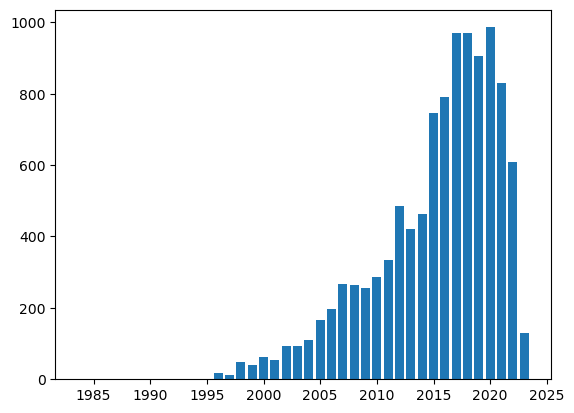

In [64]:
ct=df['Year'].value_counts()
print(ct)
df.loc[df['Year'] == 1.0, 'Year'] = None
plt.bar(ct.index,ct.values)
plt.show()

# nombre de son par artiste

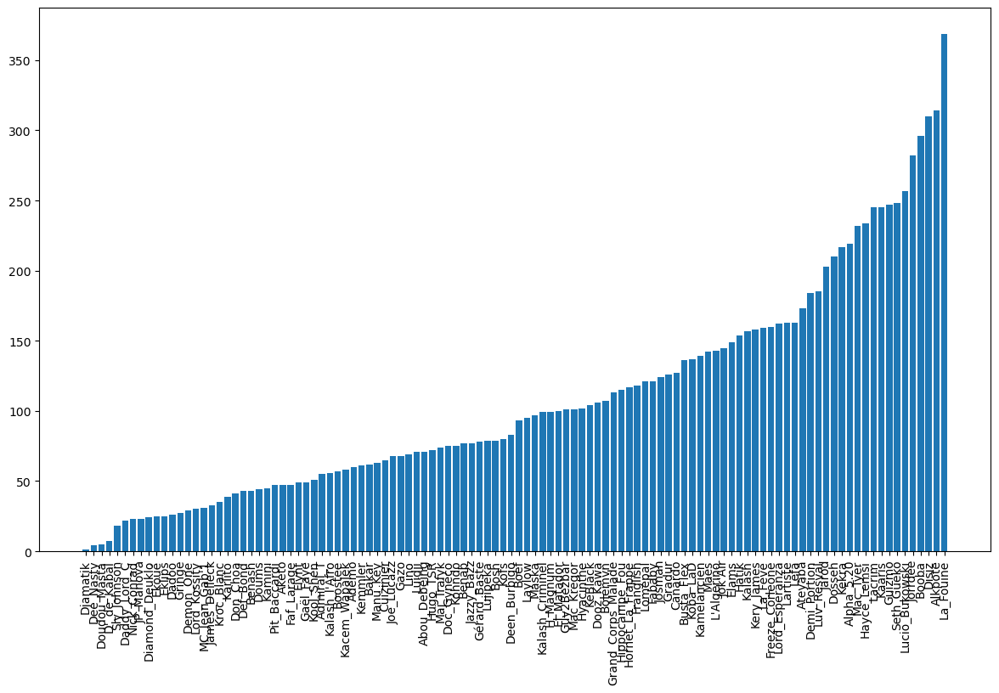

In [73]:
fig = plt.figure(figsize=(14, 8))
resultat=df.groupby('Artist').size().sort_values()
plt.bar(resultat.index,resultat.values)
plt.xticks(rotation=90)
fig.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.2, hspace=0.2)
plt.show()

# nombre de feat par artiste

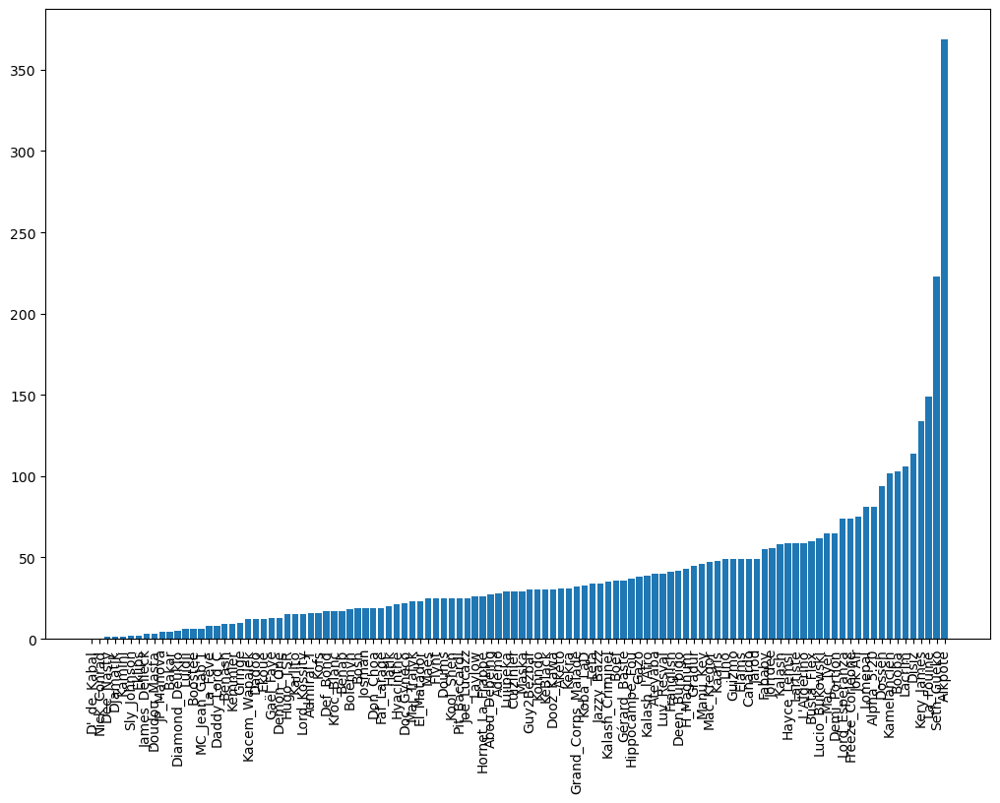

In [74]:
fig = plt.figure(figsize=(12, 8))
resultat = df.groupby('Artist')['Number of featured artists'].sum().sort_values()
resultat
plt.bar(resultat.index,resultat.values)
plt.xticks(rotation=90)
fig.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.2, hspace=0.2)
plt.show()

<function matplotlib.pyplot.show(close=None, block=None)>

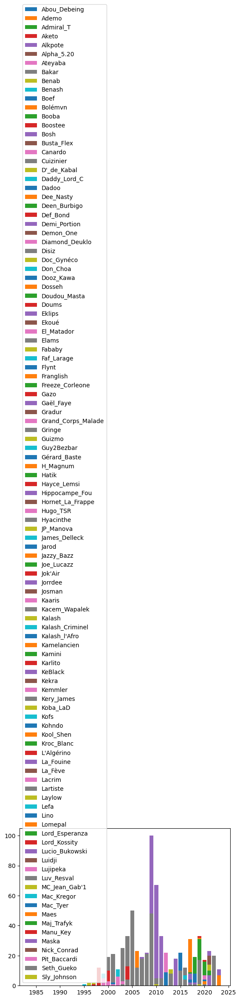

In [69]:
table_pivot = pd.pivot_table(df, values='Number of featured artists', index='Year', columns='Artist', aggfunc=sum)
#print(table_pivot)

for artist in table_pivot.columns:
    plt.bar(table_pivot.index, table_pivot[artist], label=artist)
plt.legend()
plt.show

text=open("./FrenchRapLyricsAnalyzer/genius/artistsJSON/Freeze_Corleone/lyrics_freeze_corleone.txt", "r", encoding='utf-8')
read=text.read()
#print(read)

# traitement lyrics

In [75]:
df['Lyrics']=df['Lyrics'].apply(lambda x:re.sub(r'\[(.*?)\]', '', x,flags=re.DOTALL))
df['Lyrics']=df['Lyrics'].apply(lambda x:re.sub(r'\((.*?)\)', '', x,flags=re.DOTALL))
df['Lyrics']=df['Lyrics'].apply(lambda x:x.replace("'",' '))
df['Lyrics']=df['Lyrics'].apply(lambda x:x.replace(",",' '))
df['Lyrics']=df['Lyrics'].apply(lambda x:x.replace("You might also like",' '))
df['Lyrics']=df['Lyrics'].apply(lambda x:x.replace("XXX",''))
df['Lyrics']=df['Lyrics'].apply(lambda x:x.replace("\n",' '))
df['Lyrics']=df['Lyrics'].apply(lambda x:x.lower())
df

Year  \
0      2011.0   
1      2009.0   
2      2009.0   
3      2012.0   
4         NaN   
...       ...   
11884  2003.0   
11885  1999.0   
11886  2010.0   
11887  2016.0   
11888  2003.0   

                                                                       Song Title  \
0                                                         185 Litrons (Ft. N.O.S)   
1                                                                      1mn guinze   
2                                        À l'heure où je chante (Ft. Farah (FRA))   
3                                                   À mon signal (Ft. Mac Kregor)   
4                                                                          Ariba*   
...                                                                           ...   
11884                                                                      Paname   
11885  Paraît qu't'es hardcore (Ft. Cynéfro, Delta (FRA), FDY Phenomen & Karlito)   
11886                                                               P'tit Charles   
11887                                                                       Renoi   
11888                                                        Une Journée Sans Fin   

              Artist  \
0              Ademo   
1              Ademo   
2              Ademo   
3              Ademo   
4              Ademo   
...              ...   
11884  MC_Jean_Gab'1   
11885  MC_Jean_Gab'1   
11886  MC_Jean_Gab'1   
11887  MC_Jean_Gab'1   
11888  MC_Jean_Gab'1   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                              

In [ ]:
#faire la moyenne des mots trop employés pour vérifier

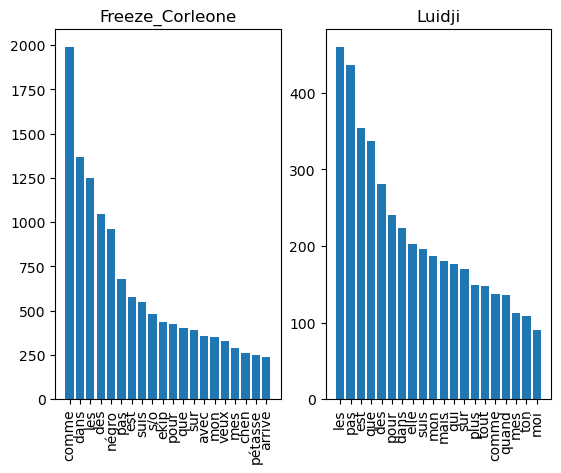

In [39]:
for artiste in df['Artist'].unique():
    n=20
    # Filtrer le dataframe pour ne contenir que les chansons de l'artiste
    chansons_artiste = df.loc[df['Artist'] == artiste, 'Lyrics']
    
    # Concaténer tous les titres en une seule chaîne de caractères
    texte = ' '.join(chansons_artiste)
    texte= " ".join([mot for mot in texte.split() if len(mot) >= 3])
    # Supprimer les mots fréquents de la chaîne de caractères
    #texte = ' '.join([mot for mot in texte.split() if mot not in mots_frequents])
    
    compteur = Counter(texte.split())
    
    # Afficher le nuage de mots sur un sous-graphique séparé
    mots_frequents = [mot for mot, occ in compteur.most_common(n)]
    occurrences = [occ for mot, occ in compteur.most_common(n)]
    plt.subplot(1, len(df['Artist'].unique()), list(df['Artist'].unique()).index(artiste)+1)
    plt.bar(mots_frequents, occurrences)
    plt.xticks(rotation=90)
    plt.title(artiste)

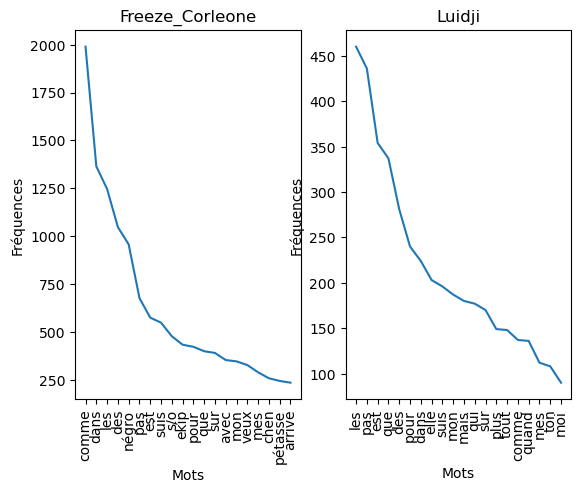

In [40]:
for artiste in df['Artist'].unique():
    n=20
    # Filtrer le dataframe pour ne contenir que les chansons de l'artiste
    chansons_artiste = df.loc[df['Artist'] == artiste, 'Lyrics']
    
    # Concaténer tous les titres en une seule chaîne de caractères
    texte = ' '.join(chansons_artiste)
    texte= " ".join([mot for mot in texte.split() if len(mot) >= 3])
   
    
    compteur = Counter(texte.split())
    top_20 = compteur.most_common(n)

    words = [x[0] for x in top_20]
    frequencies = [x[1] for x in top_20]



    # Afficher le nuage de mots sur un sous-graphique séparé

    
    plt.subplot(1, len(df['Artist'].unique()), list(df['Artist'].unique()).index(artiste)+1)
    plt.plot(words, frequencies)
    plt.xlabel('Mots')
    plt.ylabel('Fréquences')
    plt.xticks(rotation=90)
    plt.title(artiste)

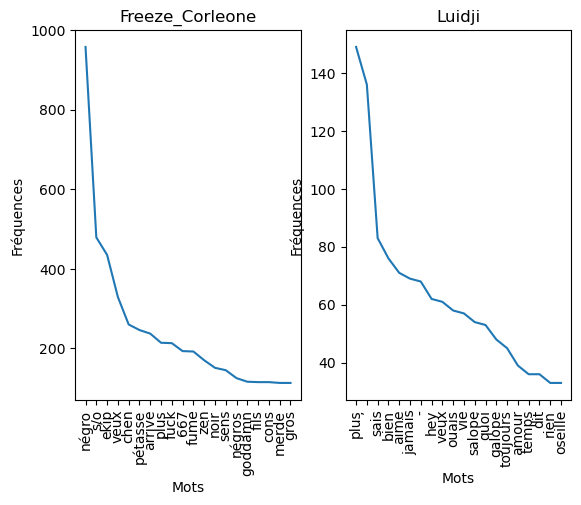

In [41]:
for artiste in df['Artist'].unique():
    n=20
    # Filtrer le dataframe pour ne contenir que les chansons de l'artiste
    chansons_artiste = df.loc[df['Artist'] == artiste, 'Lyrics']
    
    # Concaténer tous les titres en une seule chaîne de caractères
    texte = ' '.join(chansons_artiste)
    texte= " ".join([mot for mot in texte.split() if len(mot) >= 3])
   
    mots_a_supprimer_pattern = r'\b(?:{})\b'.format('|'.join(stop_words))
    nouveau_text = re.sub(mots_a_supprimer_pattern, '', texte, flags=re.DOTALL)
    compteur = Counter(nouveau_text.split())
    top_20 = compteur.most_common(n)

    words = [x[0] for x in top_20]
    frequencies = [x[1] for x in top_20]



    # Afficher le nuage de mots sur un sous-graphique séparé

    
    plt.subplot(1, len(df['Artist'].unique()), list(df['Artist'].unique()).index(artiste)+1)
    plt.plot(words, frequencies)
    plt.xlabel('Mots')
    plt.ylabel('Fréquences')
    plt.xticks(rotation=90)
    plt.title(artiste)

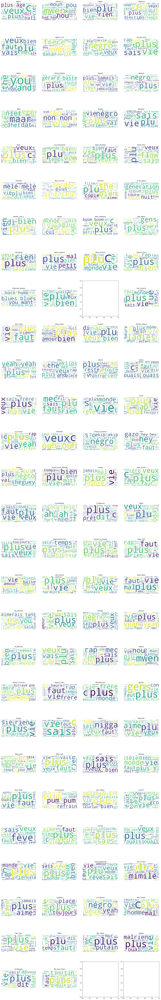

In [85]:
stop_words = get_stop_words('fr')
fig, axs = plt.subplots(nrows=int(np.ceil(len(df['Artist'].unique()) / 4)), ncols=4, figsize=(18, 4*int(np.ceil(len(df['Artist'].unique()) / 4))))

for i, artiste in enumerate(df['Artist'].unique()):
    # Filtrer le dataframe pour ne contenir que les chansons de l'artiste
    chansons_artiste = df.loc[df['Artist'] == artiste, 'Lyrics']
    
    # Concaténer tous les titres en une seule chaîne de caractères
    texte = ' '.join(chansons_artiste)
    texte= " ".join([mot for mot in texte.split() if len(mot) >= 3])
    # Supprimer les mots fréquents de la chaîne de caractères
    #texte = ' '.join([mot for mot in texte.split() if mot not in mots_frequents])
    if(len(texte)!=0):
    # Générer le nuage de mots pour l'artiste
        wordcloud = WordCloud(background_color='white', stopwords=stop_words, max_words=70).generate(texte)
    
    # Afficher le nuage de mots sur un sous-graphique séparé
        #plt.subplot(1, len(df['Artist'].unique()), list(df['Artist'].unique()).index(artiste)+1)
        axs[i//4, i%4].imshow(wordcloud)
        axs[i//4, i%4].axis("off")
        axs[i//4, i%4].set_title(artiste)
plt.tight_layout()
plt.show()

# richesse du vocabulaire

In [80]:
resultat = df.groupby('Artist')['Lyrics'].apply(lambda x: x.str.cat(sep=' ')).reset_index()
resultat['Mots'] = resultat['Lyrics'].str.split().apply(len)
resultat['Ratio'] = len(set( resultat['Mots'])) / resultat['Mots']
resultat = resultat.sort_values(by='Ratio')
resultat

Artist  \
85        La_Fouine   
4           Alkpote   
27            Disiz   
49           Guizmo   
54      Hayce_Lemsi   
..              ...   
26   Diamond_Deuklo   
109     Sly_Johnson   
33     Doudou_Masta   
21        Dee_Nasty   
28         Djamatik   

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                        

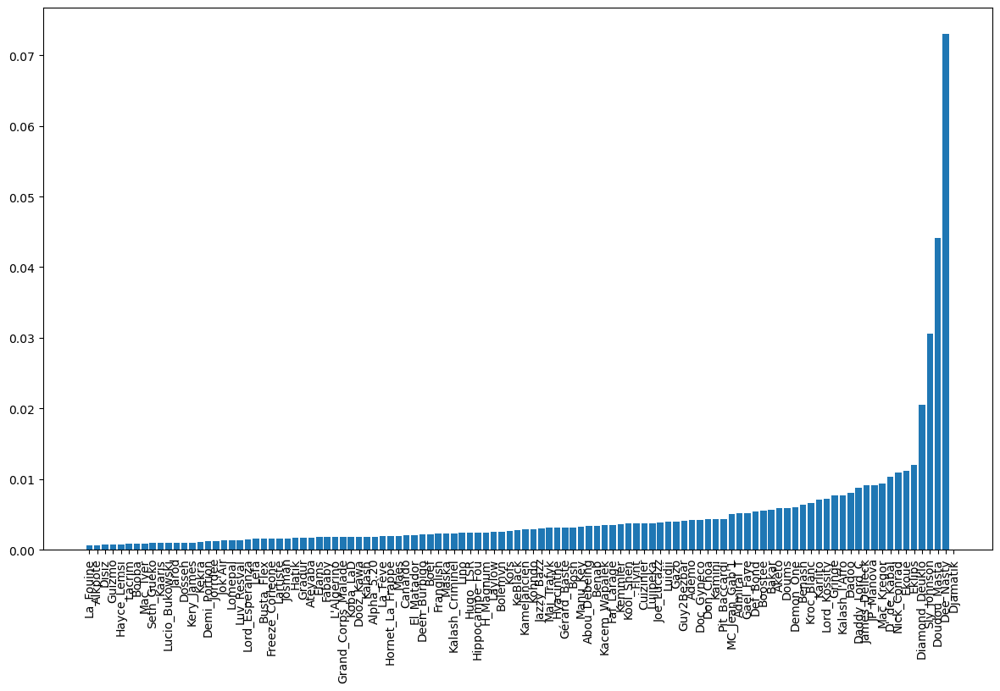

In [82]:
fig = plt.figure(figsize=(14, 8))
plt.bar(resultat['Artist'],resultat['Ratio'])
plt.xticks(rotation=90)
fig.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.2, hspace=0.2)
plt.show()

In [ ]:
texte=re.sub(r'\[(.*?)\]', '', read,flags=re.DOTALL)
texte=re.sub(r'\((.*?)\)', '', texte,flags=re.DOTALL)
texte=texte.replace("'",' ')
texte=texte.replace(",",' ')
texte=texte.replace("You might also like",'')
texte=texte.replace("XXX",'')
texte=texte.lower()
print(texte)

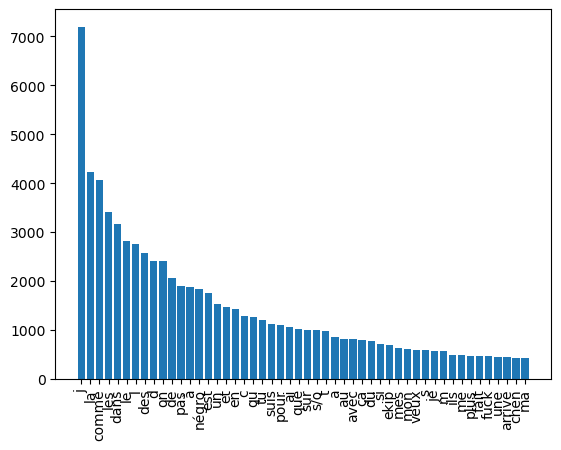

In [56]:
mots = texte.split()
compteur = Counter(mots)
#print(compteur)

n = 50
mots_frequents = [mot for mot, occ in compteur.most_common(n)]
occurrences = [occ for mot, occ in compteur.most_common(n)]
plt.bar(mots_frequents, occurrences)
plt.xticks(rotation=90)
plt.show()

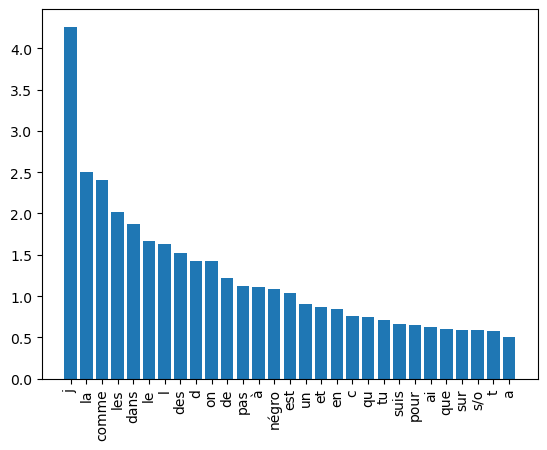

In [59]:
mots = texte.split()
compteur = Counter(mots)
nb_total_mots = len(mots)

# Créer une liste de tuples contenant chaque mot et sa fréquence
mots_freq = [(mot, occ / nb_total_mots * 100) for mot, occ in compteur.items()]

# Trier la liste de tuples en fonction de la fréquence décroissante
mots_freq_tries = sorted(mots_freq, key=lambda x: x[1], reverse=True)

# Définir un seuil pour le pourcentage de présence des mots que vous souhaitez afficher
seuil = 0.5

mots_frequents = [mot for mot, freq in mots_freq_tries if freq >= seuil]
pourcentages = [freq for mot, freq in mots_freq_tries if freq >= seuil]
plt.bar(mots_frequents, pourcentages)
plt.xticks(rotation=90)
plt.show()

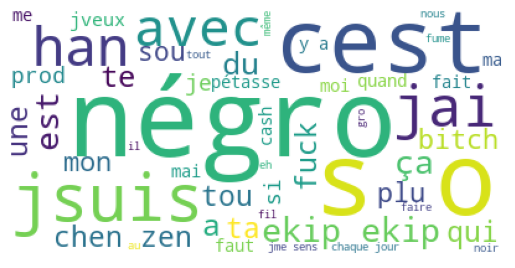

In [18]:
wordcloud = WordCloud(background_color = 'white', stopwords = mots_frequents, max_words = 50).generate(texte)
plt.imshow(wordcloud)
plt.axis("off")
plt.show();

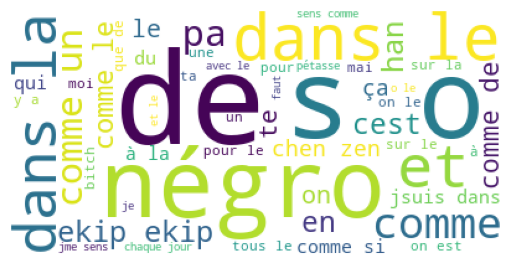

In [20]:
wordcloud = WordCloud(background_color = 'white', stopwords = [], max_words = 50).generate(texte)
plt.imshow(wordcloud)
plt.axis("off")
plt.show();

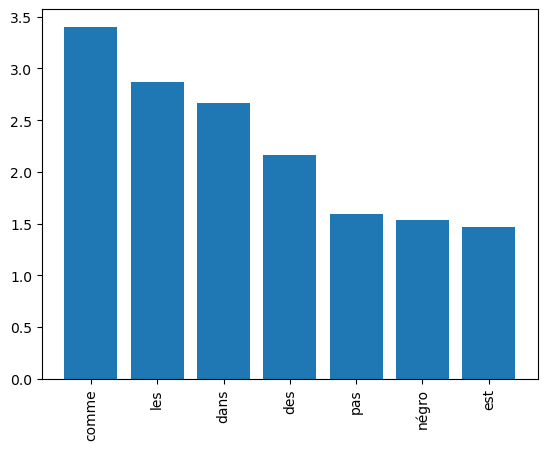

In [58]:
nouveau_texte = " ".join([mot for mot in texte.split() if len(mot) >= 3])
#print(nouveau_texte)

mots = nouveau_texte.split()
compteur = Counter(mots)
nb_total_mots = len(mots)

# Créer une liste de tuples contenant chaque mot et sa fréquence
mots_freq = [(mot, occ / nb_total_mots * 100) for mot, occ in compteur.items()]

# Trier la liste de tuples en fonction de la fréquence décroissante
mots_freq_tries = sorted(mots_freq, key=lambda x: x[1], reverse=True)

# Définir un seuil pour le pourcentage de présence des mots que vous souhaitez afficher
seuil = 1

mots_frequents = [mot for mot, freq in mots_freq_tries if freq >= seuil]
pourcentages = [freq for mot, freq in mots_freq_tries if freq >= seuil]
plt.bar(mots_frequents, pourcentages)
plt.xticks(rotation=90)
plt.show()

In [60]:
print(mots_frequents)

['j', 'la', 'comme', 'les', 'dans', 'le', 'l', 'des', 'd', 'on', 'de', 'pas', 'à', 'négro', 'est', 'un', 'et', 'en', 'c', 'qu', 'tu', 'suis', 'pour', 'ai', 'que', 'sur', 's/o', 't', 'a']


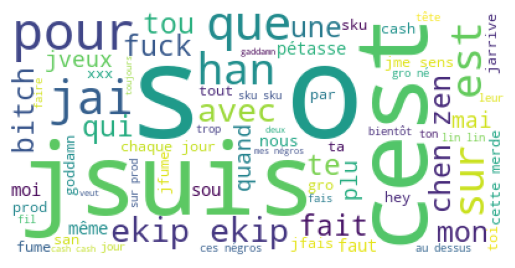

In [22]:
wordcloud = WordCloud(background_color = 'white', stopwords = mots_frequents, max_words = 70).generate(nouveau_texte)
plt.imshow(wordcloud)
plt.axis("off")
plt.show();

In [80]:
stopwords = set(STOPWORDS)
print(stopwords)

{"there's", 'up', 'she', "who's", 'my', "here's", 'himself', "that's", 'there', "wouldn't", 'their', "isn't", 'down', 'such', 'from', 'itself', 'having', "what's", 'so', 'against', "it's", 'between', 'since', 'but', 'myself', 'out', 'until', 'nor', 'also', 'http', 'than', 'can', 'him', 'get', "they'd", 'which', "why's", "wasn't", 'being', 'ourselves', 'those', 'me', 'have', 'you', "you've", 'if', 'would', 'the', 'each', 'after', "he'd", 'with', 'and', "mustn't", "shan't", 'both', 'our', 'com', 'his', 'then', 'had', 'we', 'few', "let's", "how's", 'yourself', 'else', 'in', 'where', 'therefore', 'why', 'he', 'what', 'yourselves', "we've", "you'll", 'about', "doesn't", 'however', "they'll", "weren't", 'because', "i'll", 'these', 'its', 'all', 'off', 'hers', "won't", 'be', 'how', 'more', 'are', 'was', 'they', 'do', 'over', 'hence', 'only', 'below', "haven't", "we'll", 'been', 'again', "she'll", 'k', 'her', "i'm", 'some', "when's", 'r', "he'll", 'own', 'too', "couldn't", 'or', 'your', "aren'

In [10]:
from stop_words import get_stop_words

stop_words = get_stop_words('fr')
print(stop_words)

['a', 'ai', 'aie', 'aient', 'aies', 'ait', 'alors', 'as', 'au', 'aucun', 'aura', 'aurai', 'auraient', 'aurais', 'aurait', 'auras', 'aurez', 'auriez', 'aurions', 'aurons', 'auront', 'aussi', 'autre', 'aux', 'avaient', 'avais', 'avait', 'avant', 'avec', 'avez', 'aviez', 'avions', 'avoir', 'avons', 'ayant', 'ayez', 'ayons', 'bon', 'car', 'ce', 'ceci', 'cela', 'ces', 'cet', 'cette', 'ceux', 'chaque', 'ci', 'comme', 'comment', 'd', 'dans', 'de', 'dedans', 'dehors', 'depuis', 'des', 'deux', 'devoir', 'devrait', 'devrez', 'devriez', 'devrions', 'devrons', 'devront', 'dois', 'doit', 'donc', 'dos', 'droite', 'du', 'dès', 'début', 'dù', 'elle', 'elles', 'en', 'encore', 'es', 'est', 'et', 'eu', 'eue', 'eues', 'eurent', 'eus', 'eusse', 'eussent', 'eusses', 'eussiez', 'eussions', 'eut', 'eux', 'eûmes', 'eût', 'eûtes', 'faire', 'fais', 'faisez', 'fait', 'faites', 'fois', 'font', 'force', 'furent', 'fus', 'fusse', 'fussent', 'fusses', 'fussiez', 'fussions', 'fut', 'fûmes', 'fût', 'fûtes', 'haut', 'ho

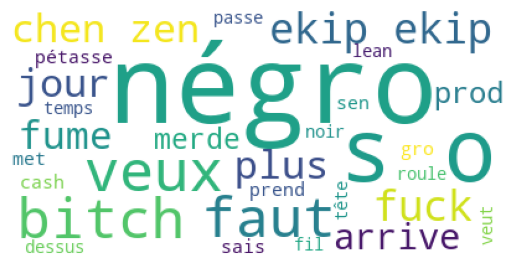

In [61]:
mots_frequents=['l','j','la', 'les', 'dans', 'le', 'des', 'on', 'de', 'pas', 'à', 'et', 'un', 'en', 'tu', 'pour', 'jsuis', 'cest', 'sur', 'que', 'jai', 'au', 'avec']
wordcloud = WordCloud(background_color = 'white', stopwords = stop_words + mots_frequents, max_words = 30).generate(nouveau_texte)
plt.imshow(wordcloud)
plt.axis("off")
plt.show();

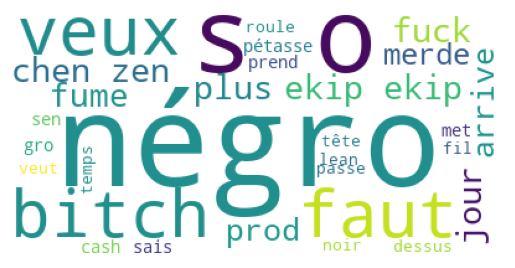

In [62]:
wordcloud = WordCloud(background_color = 'white', stopwords = stop_words , max_words = 30).generate(nouveau_texte)
plt.imshow(wordcloud)
plt.axis("off")
plt.show();

# richesse du vocab

In [25]:
#text=open("test.txt", "r", encoding='utf-8')
#read=text.read()
stri=texte.split()

In [26]:
len(set(stri))/len(stri)

0.12399658411614005

In [27]:
len(set(stri)) #nombre de mot unique

19602

# les mots les plus utilisés

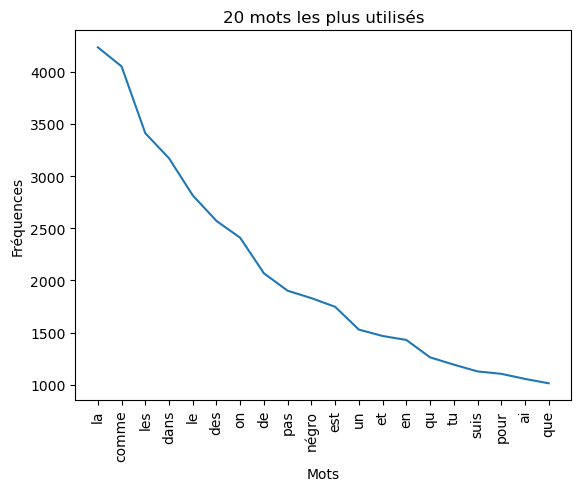

In [68]:
nouveau_texte = " ".join([mot for mot in texte.split() if len(mot) >= 2])
mots=nouveau_texte.split()
compteur = Counter(mots)

top_20 = compteur.most_common(20)

words = [x[0] for x in top_20]
frequencies = [x[1] for x in top_20]

# Tracer un graphique de la distribution des fréquences des 20 mots les plus utilisés
plt.plot(words, frequencies)
plt.xlabel('Mots')
plt.ylabel('Fréquences')
plt.title('20 mots les plus utilisés')
plt.xticks(rotation=90)
plt.show()

#plt.bar(mots_frequents, pourcentages)
#plt.xticks(rotation=90)
#plt.show()

In [67]:
#stop_words_delete= "|".join(stop_words)
#nouveau_text=texte.replace(stop_words_delete, "")

mots_a_supprimer_pattern = r'\b(?:{})\b'.format('|'.join(stop_words))
nouveau_text = re.sub(mots_a_supprimer_pattern, '', texte, flags=re.DOTALL)


print(nouveau_text)



   fonce-dé  compter combien    haters   liste  merde
faut    blesse  putain    c   suceurs  bites
hey  ov docteur   sais     putain  mauvais gro-né  eh
      10  haha
négro   sais      binks   jours  eh
ouais   fouette     10  eh
ovg doc - trap luxe    bacs     10  hey

compte   dix négros   fouette
compte jusqu  dix négro    fouette
6-6-7   r connais  secte
propagation noire   peste
 veux   poches tombent enceintes  billets
full cash full do   peux plus trier
 vendre  âme      juré
 pense  dieu surtout     prié
ov doc  eh
     remémore  trucs   regrette    fuck  eh
 principes restent  mêmes      jamais  baisse  froc  eh
gros pers    matin fuck   fuck    malade    botte
  sors  glock  espère   vas shot  fils  pute  ov

   fonce-dé  compter combien    haters   liste  merde
faut    blesse  putain    c   suceurs  bites
hey  ov docteur   sais     putain  mauvais gro-né  eh
      10  haha
négro   sais      binks   jours  eh
ouais   fouette     10  eh
ovg doc - trap luxe    bacs     10  h

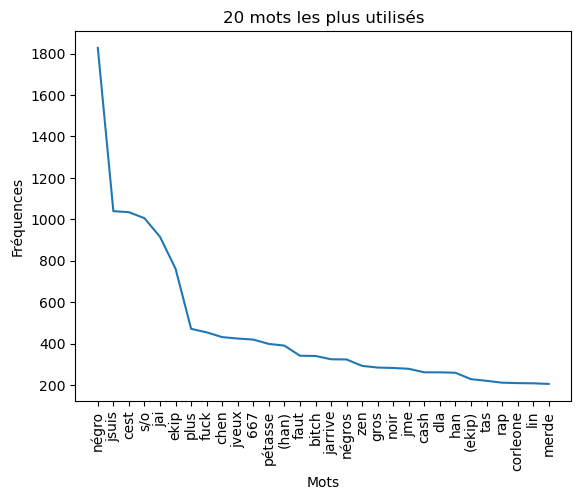

In [35]:
nouveau_texte = " ".join([mot for mot in nouveau_text.split() if len(mot) >= 2])
mots = nouveau_texte.split()
compteur = Counter(mots)

top_20 = compteur.most_common(30)

words = [x[0] for x in top_20]
frequencies = [x[1] for x in top_20]

# Tracer un graphique de la distribution des fréquences des 20 mots les plus utilisés
plt.plot(words, frequencies)
plt.xlabel('Mots')
plt.ylabel('Fréquences')
plt.title('20 mots les plus utilisés')
plt.xticks(rotation=90)
plt.show()

# Nombre moyen de mot par titre

# Les mots les plus utilisé en fonction de l'année

# Nombre de son par artistes

# nombre de mots moyen, nombre de mot unique en fonction de la date ou de l'artiste